<div align="center">
    <a href="https://www.visual-layer.com" target="_blank" rel="noopener noreferrer">
    <picture>
    <source media="(prefers-color-scheme: dark)" srcset="https://raw.githubusercontent.com/visual-layer/visuallayer/main/imgs/vl_horizontal_logo_dark_mode.png" width=350>
    <source media="(prefers-color-scheme: light)" srcset="https://raw.githubusercontent.com/visual-layer/visuallayer/main/imgs/vl_horizontal_logo.png" width=350>
    <img alt="vl logo." src="https://raw.githubusercontent.com/visual-layer/visuallayer/main/imgs/vl_horizontal_logo.png">
    </picture>
    </a>
    <br>
    <br>
    <a href="https://visualdatabase.slack.com/join/shared_invite/zt-19jaydbjn-lNDEDkgvSI1QwbTXSY6dlA#/shared-invite/email" target="_blank" rel="noopener noreferrer">
    <img src="https://img.shields.io/badge/JOIN US ON SLACK-4A154B?style=for-the-badge&logo=slack&logoColor=white" alt="Logo">
    </a>
    <a href="https://visual-layer.readme.io/discuss" target="_blank" rel="noopener noreferrer">
    <img src="https://img.shields.io/badge/DISCUSSION%20FORUM-slateblue?style=for-the-badge&logo=discourse&logoWidth=20" alt="Logo">
    </a>
    <a href="https://www.linkedin.com/company/visual-layer/" target="_blank" rel="noopener noreferrer">
    <img src="https://img.shields.io/badge/LinkedIn-0077B5?style=for-the-badge&logo=linkedin&logoColor=white" alt="Logo">
    </a>
    <a href="https://twitter.com/visual_layer" target="_blank" rel="noopener noreferrer">
    <img src="https://img.shields.io/badge/Twitter-1DA1F2?style=for-the-badge&logo=twitter&logoColor=white" alt="Logo">
    </a>
    <a href="https://www.youtube.com/@visual-layer" target="_blank" rel="noopener noreferrer">
    <img src="https://img.shields.io/badge/-YouTube-black.svg?style=for-the-badge&logo=youtube&colorB=red" alt="Logo">
    </a>
</div>

# Run On Pre-computed Feature Vectors

[![Open in Colab](https://img.shields.io/badge/Open%20in%20Colab-blue?style=for-the-badge&logo=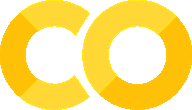&labelColor=gray)](https://colab.research.google.com/github/visual-layer/fastdup/blob/main/examples/feature_vectors.ipynb)
[![Kaggle](https://img.shields.io/badge/Open%20in%20Kaggle-blue?style=for-the-badge&logo=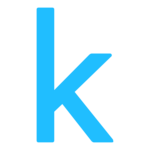&labelColor=gray)](https://kaggle.com/kernels/welcome?src=https://github.com/visual-layer/fastdup/blob/main/examples/feature_vectors.ipynb)
[![Explore the Docs](https://img.shields.io/badge/Explore%20the%20Docs-blue?style=for-the-badge&labelColor=gray&logo=read-the-docs)](https://visual-layer.readme.io/docs/run-on-precomputed-feature-vectors)


If you have pre-computed feature vectors using fastdup or any other methods, you can input the features directly into fastdup to analyze for issues. Runing fastdup on feature vectors instead of raw images decreases run time significantly.

The following code snippet shows how to run with your own feature stored in a `numpy` matrix, along with a list of the matching filenames.


```python
import numpy as np
import fastdup

# Replace the below code with computation of your own features
matrix = np.random.rand(2, 576).astype('float32')
flist = ["/data/myimage1.jpg", "/data/myimage2.jpg"]

# Files should contain absolute path and not relative path
fd = fastdup.create(input_dir='/data/', work_dir='output')  
fd.run(annotations=flist, embeddings=matrix)
```

In this notebook we show an end-to-end example on how you can pre-compute feature vectors using fastdup and DINOv2 model and use the features to surface dataset issues.

## Install fastdup

First, install fastdup and verify the installation.

In [1]:
!pip install -Uq fastdup

Now, test the installation. If there's no error message, we are ready to go.

In [2]:
import fastdup
fastdup.__version__

/usr/bin/dpkg


'1.41'

## Compute Feature Vectors

fastdup provides a convenient method to compute feature vectors for your dataset. 

For demo, let's download the Oxford-IIIT Pets dataset and extract the images into our local directory.

In [ ]:
!wget https://thor.robots.ox.ac.uk/~vgg/data/pets/images.tar.gz -O images.tar.gz
!tar xf images.tar.gz

In [6]:
fd = fastdup.create(input_dir="images/", work_dir='dinov2_feature_vectors')
fd.run(model_path='dinov2s')

CPU times: user 5 µs, sys: 0 ns, total: 5 µs
Wall time: 9.78 µs
FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
                                                                                                 
               :++.                                                  ...                                       
             ;&&$+.                               ;x:                ;;;                                       
            .$&+                                  X&x                ;;;                                       
           X$&&&$$;    :$&&$+. ;$x    .x&&&X:   ;$&&&$$$:    :;;;;:. ;;;  :;;.      .;;.  :;;  :;;;;;.         
           +x&&Xxx: :$&&Xx++X&&$&$  .&&$+;+$&&; :x&&$xxx: .;;;;;:;;;;;;;  :;;.      .;;:  :;;;;;;:;;;;;:       
            .$&;   :$&X       +&&$  ;&$.    ;XX   X&x    .;;;       ;;;;  :;;.      .;;:  :;;;.      :;;:      
            .$&;   +&&.        x&$  .$&&$+.       X&x    ;;;         ;;;  :;;.      .;;:  :

0

The above run took approximately **6.4 mins** to complete.

> There are other models available other than DINOv2s. You can even use your own ONNX model. Check out our [docs](https://visual-layer.readme.io/docs/using-your-own-model) to learn more.

## Load Pre-Computed Feature Vectors

The feature vectors are stored locally in the `dinov2_feature_vectors/atrain_features.dat` file.

Let's load them with:

In [8]:
filenames, feature_vec = fastdup.load_binary_feature("dinov2_feature_vectors/atrain_features.dat", 
                                                     d=384)

Read a total of  7384 images


In [9]:
feature_vec.shape

(7384, 384)

> + `7384` corresponds to the number of images in the dataset.
> + `384` corresponds to the output dimension of the DINOv2s model.

In [10]:
feature_vec

array([[-0.06479655, -1.4296799 , -0.9049806 , ..., -1.3630866 ,
         4.7040157 ,  2.7566783 ],
       [-1.8220993 , -0.98336047, -4.662348  , ..., -0.58889085,
         3.3827934 ,  2.8613856 ],
       [-1.9985695 , -2.0832956 , -3.7899694 , ..., -1.788193  ,
         5.519428  ,  0.91686314],
       ...,
       [-0.9273606 , -2.565295  ,  0.17525989, ..., -1.960409  ,
        -1.8258183 ,  3.7282362 ],
       [-1.6299546 , -2.55411   ,  0.30670035, ..., -1.4233751 ,
        -0.20112962,  2.5470083 ],
       [ 1.0186508 , -5.405828  ,  0.56211305, ...,  0.00601513,
        -4.175978  ,  2.0681496 ]], dtype=float32)

## Run fastdup with Pre-computed Features

To run fastdup on the pre-computed feature vectors, point the `annotations` parameter to the filenames and `embeddings` parameter to the feature vector.

In [11]:
fd = fastdup.create(input_dir="images/", work_dir='output')  
fd.run(annotations=filenames, embeddings=feature_vec)

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
                                                                                                 
               :++.                                                  ...                                       
             ;&&$+.                               ;x:                ;;;                                       
            .$&+                                  X&x                ;;;                                       
           X$&&&$$;    :$&&$+. ;$x    .x&&&X:   ;$&&&$$$:    :;;;;:. ;;;  :;;.      .;;.  :;;  :;;;;;.         
           +x&&Xxx: :$&&Xx++X&&$&$  .&&$+;+$&&; :x&&$xxx: .;;;;;:;;;;;;;  :;;.      .;;:  :;;;;;;:;;;;;:       
            .$&;   :$&X       +&&$  ;&$.    ;XX   X&x    .;;;       ;;;;  :;;.      .;;:  :;;;.      :;;:      
            .$&;   +&&.        x&$  .$&&$+.       X&x    ;;;         ;;;  :;;.      .;;:  :;;.        ;;;      
            .$&;   +&&.        x&$     ;X&&

0

The above run only took **194 ms** to complete! Compared to running fastdup without pre-computed embedding this is a **99.95%** reduction in run time!

## View Galleries

You can use all of fastdup gallery methods to view duplicates, clusters, etc.

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Finished OK. Components are stored as image files output/galleries/components_[index].jpg
Stored components visual view in  output/galleries/components.html
Execution time in seconds 0.8
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



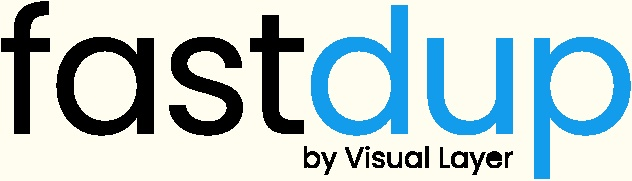
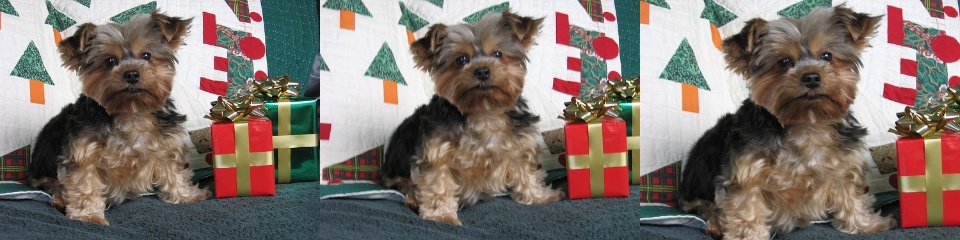
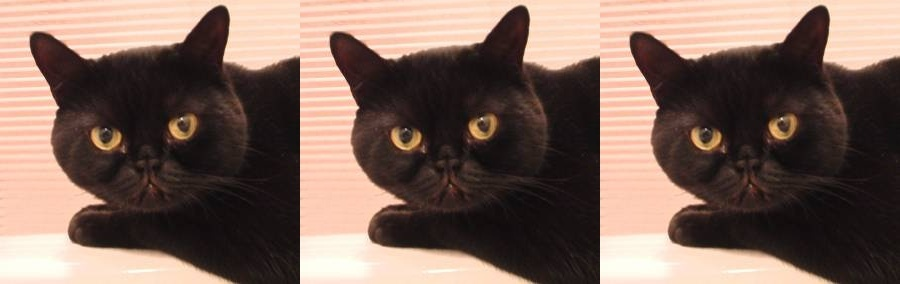
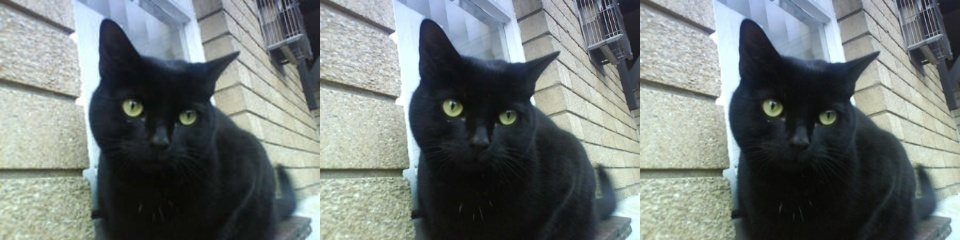
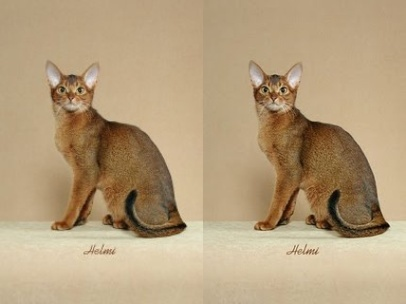
...
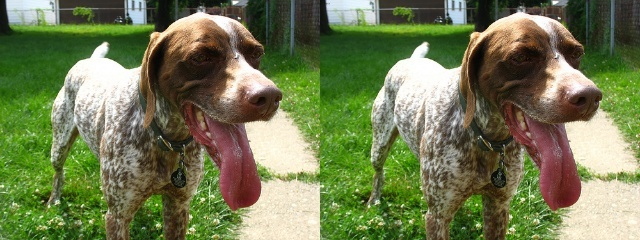
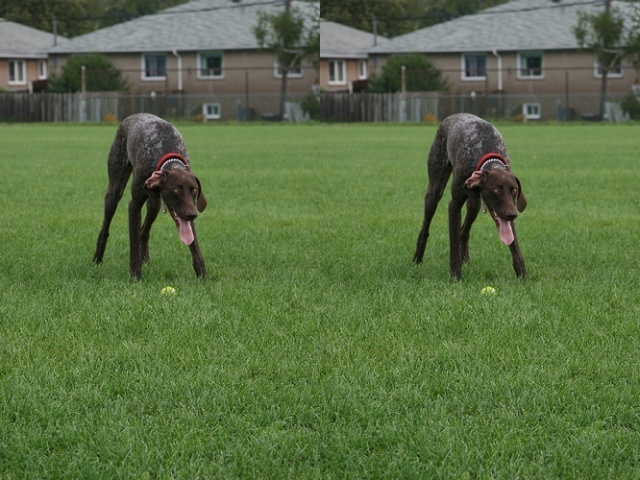
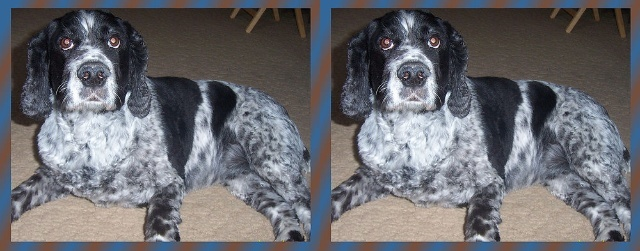
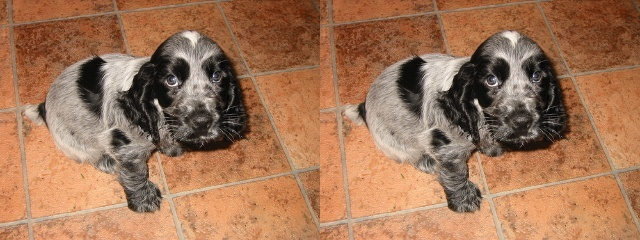
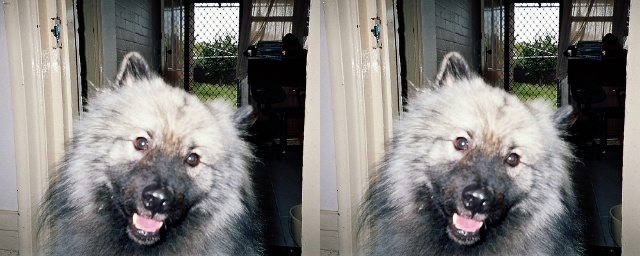

0

In [12]:
fd.vis.component_gallery()

## Change Run Parameter
Let's suppose you're not satisfied with the result and would like to tweak the `run` parameters, you can easily modify them and re-run without to run from scratch since we have the pre-computed features.

In the following run, we set a `ccthreshold` parameter to `0.8` instead of the default value `0.96`.

> Specify `overwrite=True` flag to overwrite the previous run.

In [14]:
fd.run(annotations=filenames, embeddings=feature_vec, overwrite=True, ccthreshold=0.8)

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
                                                                                                 
               :++.                                                  ...                                       
             ;&&$+.                               ;x:                ;;;                                       
            .$&+                                  X&x                ;;;                                       
           X$&&&$$;    :$&&$+. ;$x    .x&&&X:   ;$&&&$$$:    :;;;;:. ;;;  :;;.      .;;.  :;;  :;;;;;.         
           +x&&Xxx: :$&&Xx++X&&$&$  .&&$+;+$&&; :x&&$xxx: .;;;;;:;;;;;;;  :;;.      .;;:  :;;;;;;:;;;;;:       
            .$&;   :$&X       +&&$  ;&$.    ;XX   X&x    .;;;       ;;;;  :;;.      .;;:  :;;;.      :;;:      
            .$&;   +&&.        x&$  .$&&$+.       X&x    ;;;         ;;;  :;;.      .;;:  :;;.        ;;;      
            .$&;   +&&.        x&$     ;X&&

0

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Finished OK. Components are stored as image files output/galleries/components_[index].jpg
Stored components visual view in  output/galleries/components.html
Execution time in seconds 5.9
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



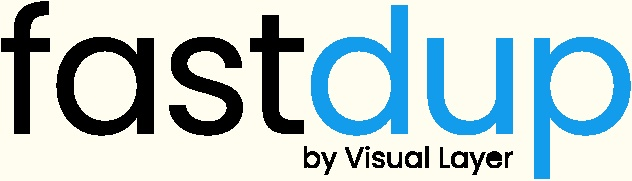
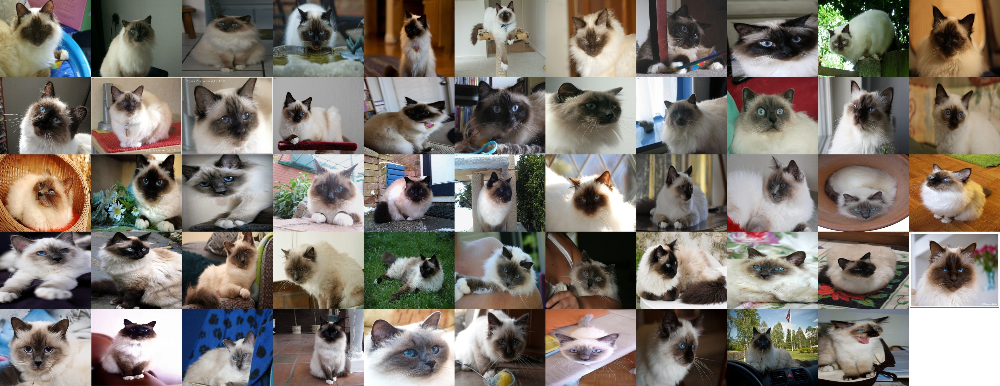
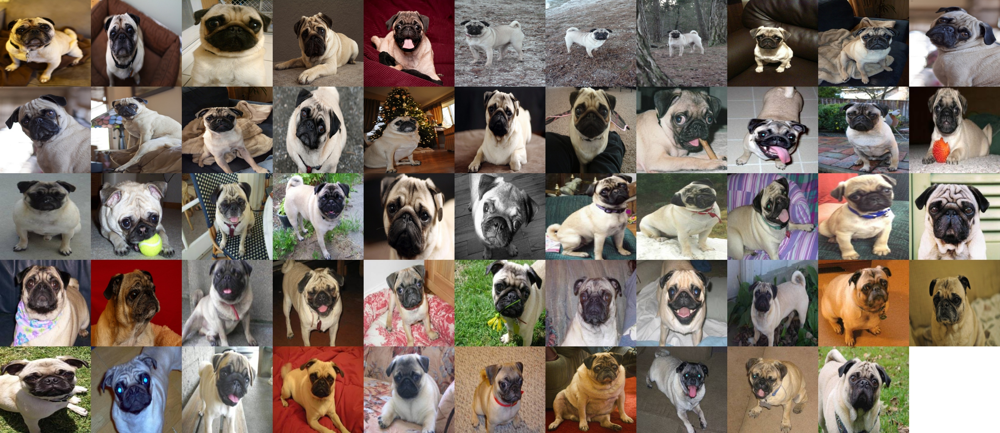
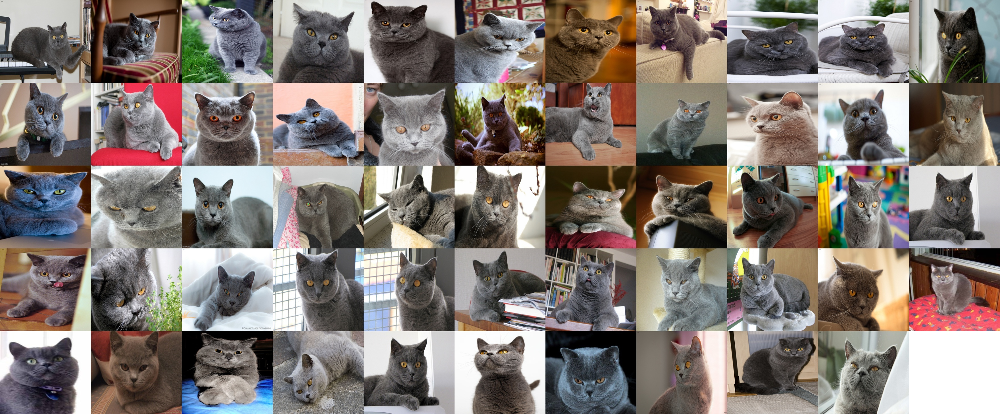
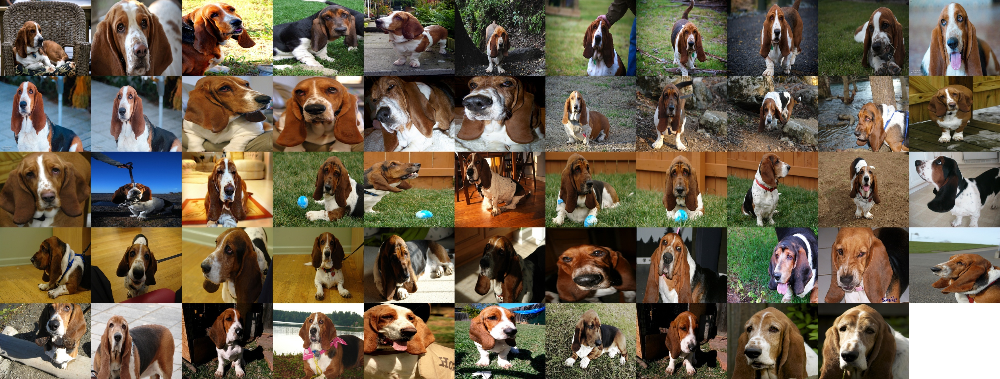
...
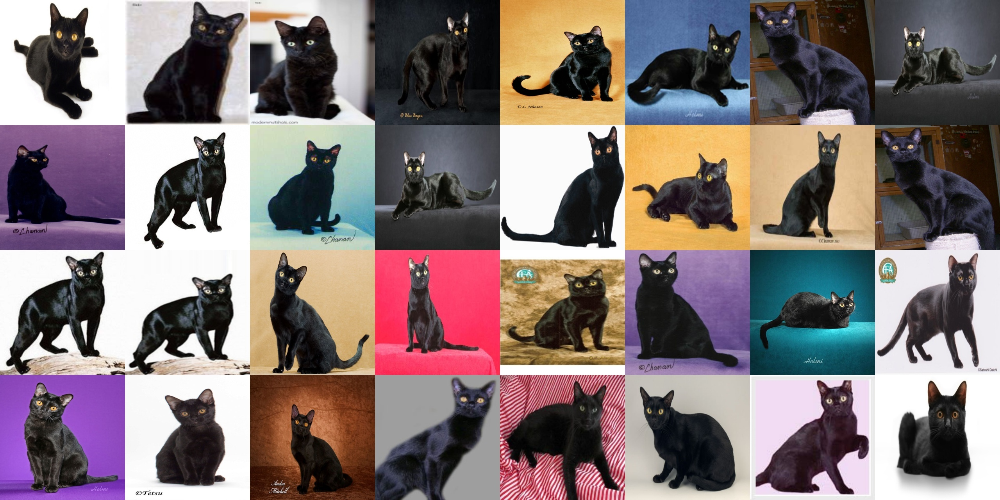
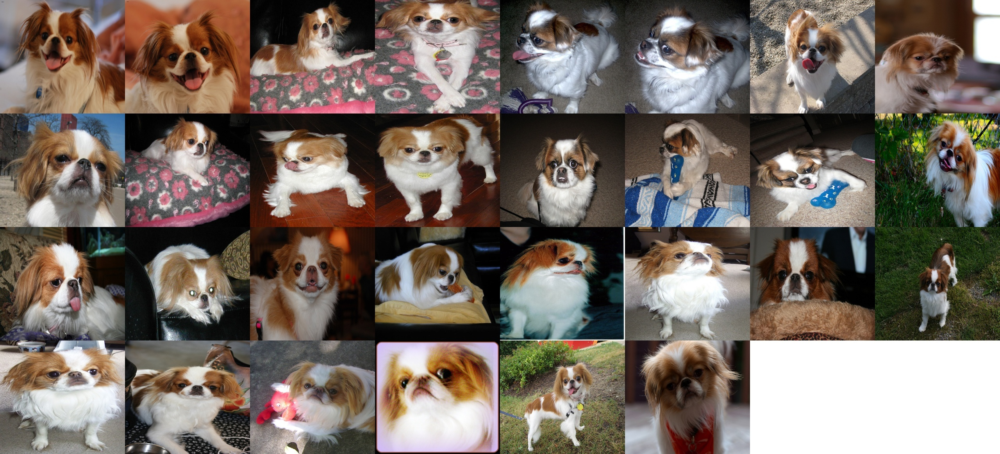
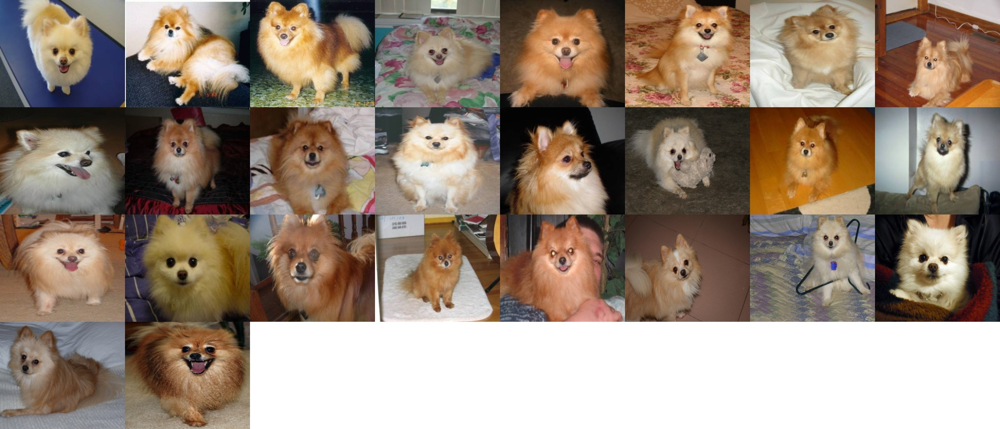
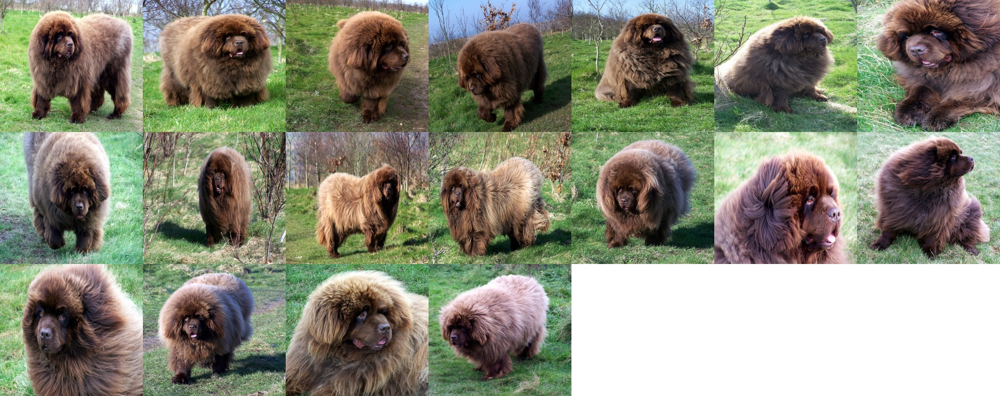
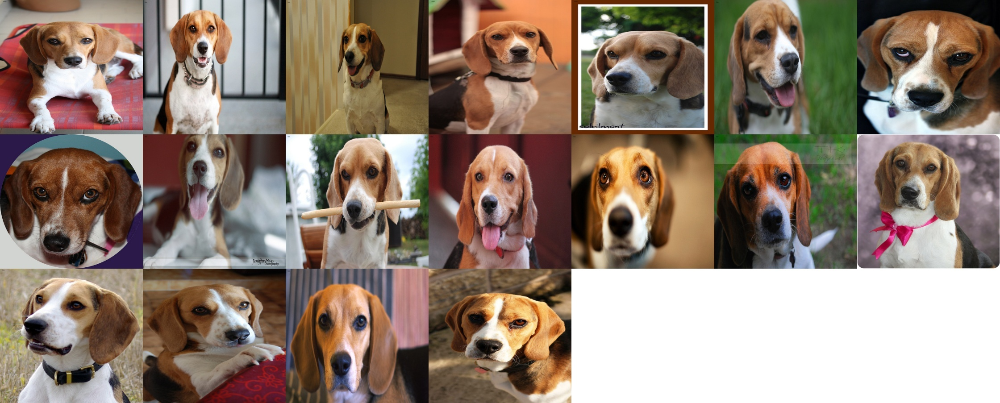

0

In [15]:
fd.vis.component_gallery()

## Wrap Up
In this tutorial, we showed how you can run fastdup using pre-computed feature vectors. Running over pre-computed feature vectors significantly reduces run time compared to running over raw image files.

Next, feel free to check out other tutorials -

+ ⚡ [**Quickstart**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/quick-dataset-analysis.ipynb): Learn how to install fastdup, load a dataset and analyze it for potential issues such as duplicates/near-duplicates, broken images, outliers, dark/bright/blurry images, and view visually similar image clusters. If you're new, start here!
+ 🧹 [**Clean Image Folder**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/cleaning-image-dataset.ipynb): Learn how to analyze and clean a folder of images from potential issues and export a list of problematic files for further action. If you have an unorganized folder of images, this is a good place to start.
+ 🖼 [**Analyze Image Classification Dataset**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/analyzing-image-classification-dataset.ipynb): Learn how to load a labeled image classification dataset and analyze for potential issues. If you have labeled ImageNet-style folder structure, have a go!
+ 🎁 [**Analyze Object Detection Dataset**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/analyzing-object-detection-dataset.ipynb): Learn how to load bounding box annotations for object detection and analyze for potential issues. If you have a COCO-style labeled object detection dataset, give this example a try.


## VL Profiler - A faster and easier way to diagnose and visualize dataset issues

If you prefer a no-code platform to inspect and visualize your dataset, [**try our free cloud product VL Profiler**](https://app.visual-layer.com) - VL Profiler is our first no-code commercial product that lets you visualize and inspect your dataset in your browser. 

VL Profiler is free to get started. Upload up to 1,000,000 images for analysis at zero cost!

[Sign up](https://app.visual-layer.com) now.

[![image](https://raw.githubusercontent.com/visual-layer/fastdup/main/gallery/github_banner_profiler.gif)](https://app.visual-layer.com)

As usual, feedback is welcome! Questions? Drop by our [Slack channel](https://visualdatabase.slack.com/join/shared_invite/zt-19jaydbjn-lNDEDkgvSI1QwbTXSY6dlA#/shared-invite/email) or open an issue on [GitHub](https://github.com/visual-layer/fastdup/issues).

<center> 
    <a href="https://visual-layer.com/" target="_blank" style="text-decoration: none;"> <img style="width:200px" alt="logo" src="https://d2iycffepdu1yp.cloudfront.net/design-assets/VL_horizontal_logo.png"> </a><br>
    <a href="https://github.com/visual-layer/fastdup" target="_blank" style="text-decoration: none;"> GitHub </a> •
    <a href="https://visual-layer.slack.com/" target="_blank" style="text-decoration: none;"> Join Slack Community </a> •
    <a href="https://visual-layer.readme.io/discuss" target="_blank" style="text-decoration: none;"> Discussion Forum </a>
</center>

<center> 
    <a href="https://medium.com/visual-layer" target="_blank" style="text-decoration: none;"> Blog </a> •
    <a href="https://visual-layer.readme.io/" target="_blank" style="text-decoration: none;"> Documentation </a> •
    <a href="https://visual-layer.com/about" target="_blank" style="text-decoration: none;"> About Us </a> 
</center>

<center> 
    <a href="https://www.linkedin.com/company/visual-layer/" target="_blank" style="text-decoration: none;"> LinkedIn </a> •
    <a href="https://twitter.com/visual_layer" target="_blank" style="text-decoration: none;"> Twitter </a>
</center>